In [1]:
] activate .

  Activating project at `~/.julia/dev/HJB`


In [2]:
] st

Project HJB v1.0.0-DEV
Status `~/.julia/dev/HJB/Project.toml`
  [0c46a032] DifferentialEquations v7.11.0
  [f6369f11] ForwardDiff v0.10.36
  [7f7a1694] Optimization v3.19.2
  [36348300] OptimizationOptimJL v0.1.12
  [90137ffa] StaticArrays v1.6.5
  [e88e6eb3] Zygote v0.6.66
  [37e2e46d] LinearAlgebra


In [3]:
using StaticArrays, DifferentialEquations, ForwardDiff, Optimization, OptimizationOptimJL, Zygote, Plots

┌ Error: Error during loading of extension ZygoteColorsExt of Zygote, use `Base.retry_load_extensions()` to retry.
│   exception =
│    1-element ExceptionStack:
│    MethodError: no method matching pipe_writer(::IJulia.IJuliaStdio{Base.PipeEndpoint})
│    The applicable method may be too new: running in world age 31401, while current world is 31615.
│    
│    Closest candidates are:
│      pipe_writer(::IJulia.IJuliaStdio) (method too new to be called from this world context.)
│       @ IJulia ~/.julia/packages/IJulia/Vo51o/src/stdio.jl:15
│      pipe_writer(::Base.ProcessChain)
│       @ Base process.jl:36
│      pipe_writer(::Base.Process)
│       @ Base process.jl:22
│      ...
│    
│    Stacktrace:
│      [1] setup_stdio(stdio::IJulia.IJuliaStdio{Base.PipeEndpoint}, readable::Bool)
│        @ Base ./process.jl:260
│      [2] setup_stdios(f::Base.var"#784#785"{Cmd}, stdios::Vector{Union{RawFD, IO}})
│        @ Base ./process.jl:221
│      [3] _spawn
│        @ Base ./process.jl:1

In [4]:
function f(t, x, u)
    return @SVector [x[2], u[1]]
end

f (generic function with 1 method)

In [5]:
function l(x)
    # l(x) >= 0 is the safe set
    return 1.5 - x[1] 
end

l (generic function with 1 method)

In [74]:
function H(t, x, V, DxV) 
    u2 = @SVector [-1.0]
    H2 = DxV' * f(t, x, u2)
    γ = 1.0
    # return min(0, H2 + γ*V)
    return  H2 + γ*V
end

function DsH(t, x, V, DxV)
    return ForwardDiff.gradient(s-> H(t, x, V, s), DxV)
end



function DxH(t, x, V, DxV)
    return ForwardDiff.gradient(xx-> H(t, xx, V, DxV), x)
end



function DzH(t, x, V, DxV)
    return ForwardDiff.derivative(z-> H(t, x, z, DxV), V)
end

DzH (generic function with 1 method)

In [75]:
DsH(0.0, [1.0, 1.0], 1.0, [1.0, 1.0])

2-element Vector{Float64}:
  1.0
 -1.0

In [76]:
DxH(0.0, [1.0, 1.0], 1.0, [1.0, 1.0])

2-element Vector{Float64}:
 0.0
 1.0

In [77]:
DzH(0.0, [1.0, 1.0], 1.0, [1.0, 1.0])

1.0

In [92]:
function characteristics_system!(D, X, params, t)
    # decompose the system first
    xinds = 1:2
    sinds = 3:4
    zind = 5
    zinds = 5:5
    
    x = X[xinds]
    s = X[sinds]
    z = X[zind]

    # update the values
    D[xinds] = DsH(t, x, z, s)
    D[sinds] = -DxH(t, x, z, s) - DzH(t, x, z, s) * s
    D[zinds] .= s' * DsH(t, x, z, s) # - H(t, x, z, s)
    # @show D[5]
    # @show H(t, x, z, s)
    # @show s' * DsH(t, x, z, s)

    return 
end
    

characteristics_system! (generic function with 1 method)

In [93]:
x0 = [1.0, 3.0]
s0 = [1.0, 1.0]
z0 = 0.0
X0 = vcat(x0, s0, z0)
D0 = similar(X0)

5-element Vector{Float64}:
  4.615110606101596
  1.3303303303303333
 -1.2578959713150792e18
  3.1607446684242427e18
 -2.0837283578806882e19

In [94]:
characteristics_system!(D0, X0, nothing, 0.0)

In [95]:
D0

5-element Vector{Float64}:
  3.0
 -1.0
 -1.0
 -2.0
  2.0

In [96]:
# function objective(x0, s0; tspan=(0.0, 2.0))
#     X0 = vcat(x0, s0, 0.0)
#     prob = ODEProblem(characteristics_system!, X0, tspan)
#     sol = solve(prob)
#     # @show sol
#     xend = sol.u[end][1:2]
#     zend = sol.u[end][5]

#     return sol, l(xend) + zend

# end

In [97]:
prob = ODEProblem(characteristics_system!, X0, (0.0, 2.0))

ODEProblem with uType Vector{Float64} and tType Float64. In-place: true
timespan: (0.0, 2.0)
u0: 5-element Vector{Float64}:
 1.0
 3.0
 1.0
 1.0
 0.0

In [98]:
function loss(p)
    x0 = [1.0, 3.0]
    p0 = p
    z0 = 0.0
    X0 = vcat(x0, p0, z0)

    # resolve the problem
    sol = solve(prob, Tsit5(), u0 = X0)

    # extract solution
    xend = sol.u[end][1:2]
    zend = sol.u[end][5]
    
    loss = (l(xend) + zend)

    return loss, sol
end

callback = function (p, l, pred)
    display(l)
    plt = plot(pred)
    display(plt)
    # Tell Optimization.solve to not halt the optimization. If return true, then
    # optimization stops.
    return false
end

  

#33 (generic function with 1 method)

In [99]:
adtype = Optimization.AutoZygote()
optf = Optimization.OptimizationFunction((x, p) -> loss(x), adtype)


(::OptimizationFunction{true, AutoZygote, var"#35#36", Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, typeof(SciMLBase.DEFAULT_OBSERVED_NO_TIME), Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing}) (generic function with 1 method)

In [100]:
optprob = Optimization.OptimizationProblem(optf, [0.0, 0.0])

OptimizationProblem. In-place: true
u0: 2-element Vector{Float64}:
 0.0
 0.0

-3.521616603396488

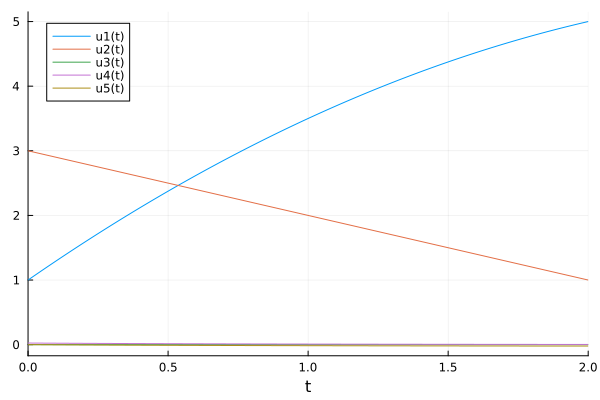

-3.6621246930429465

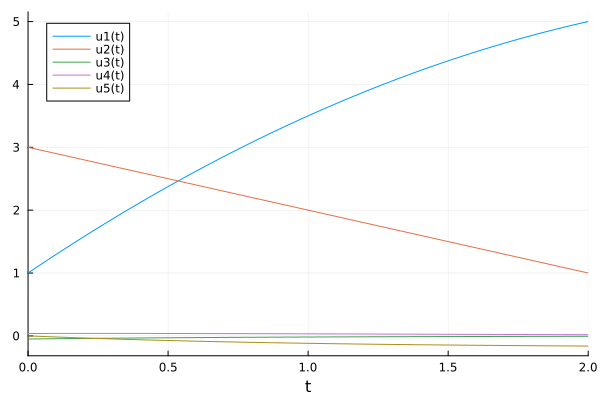

-3.7756119705474838

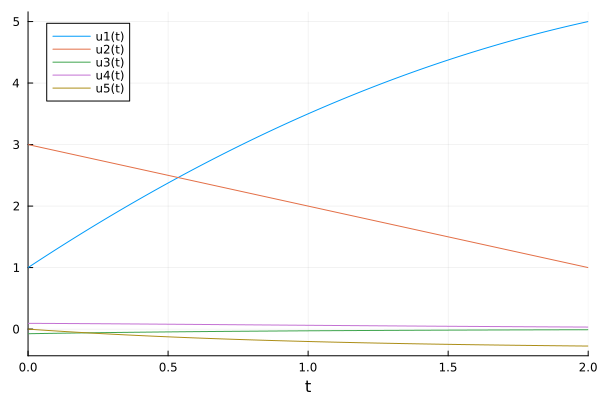

-4.113371850857257

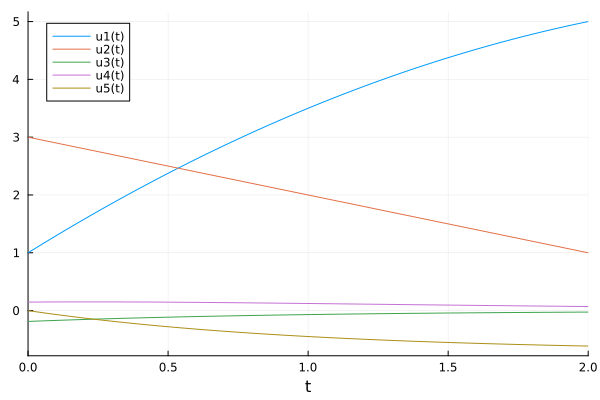

-4.509226318767858

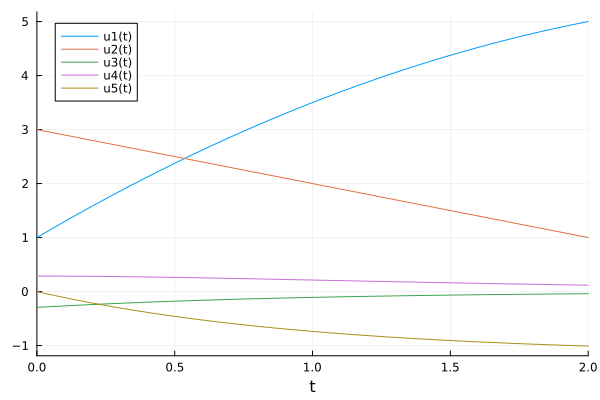

-5.382672957432126

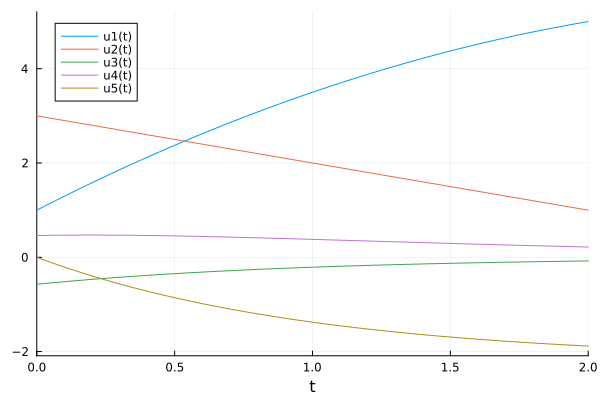

-6.611105317151178

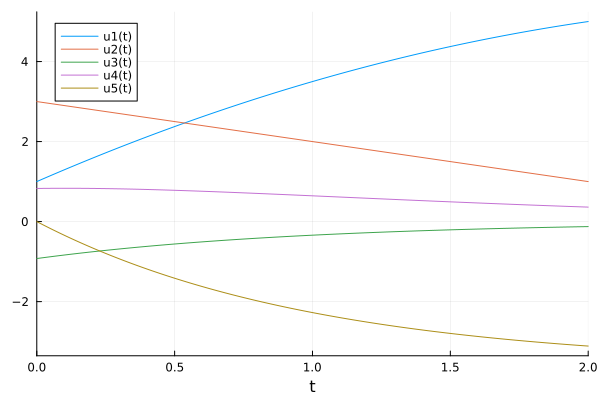

-8.972216071435444

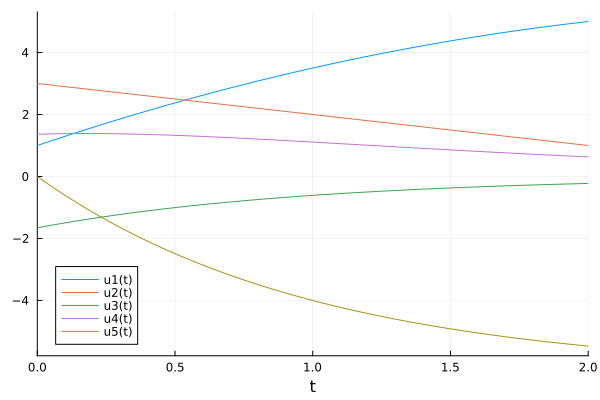

-12.609635343561408

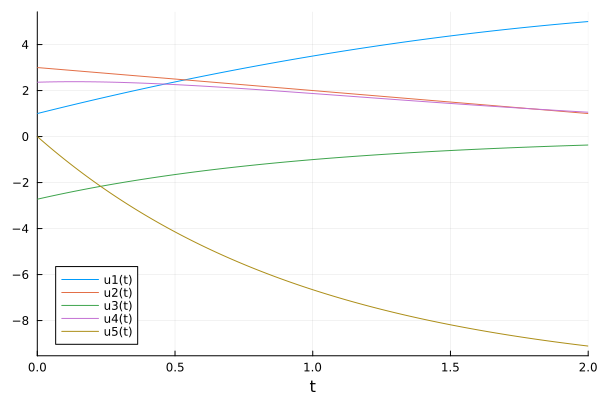

-19.15056363117619

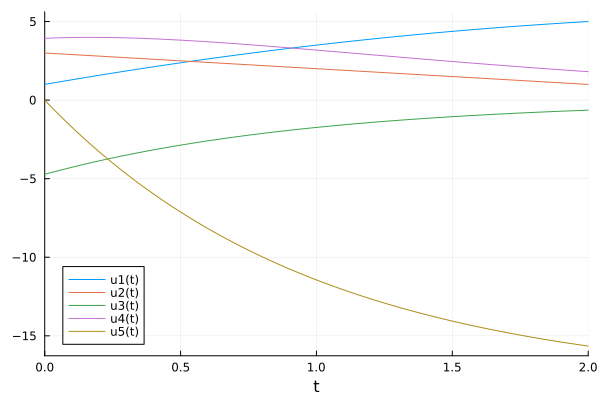

-29.695866523783355

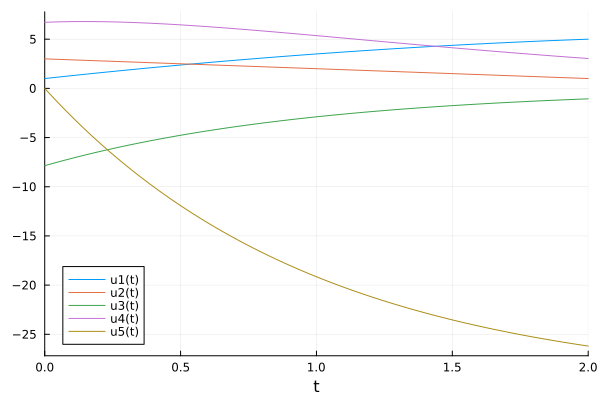

-48.05038842388083

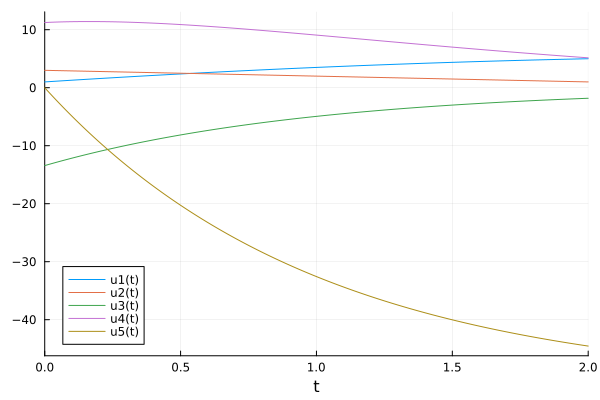

-78.31824902068453

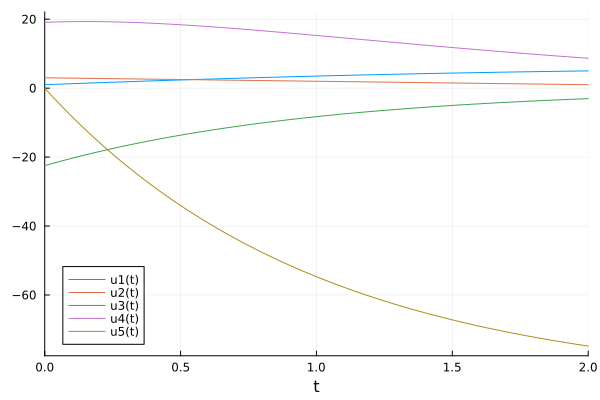

-130.1611942313637

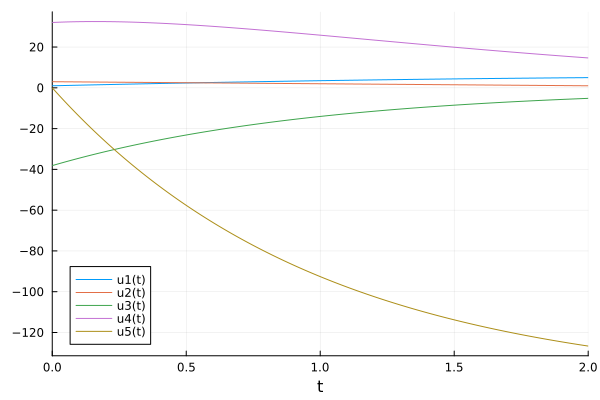

-216.6183851901088

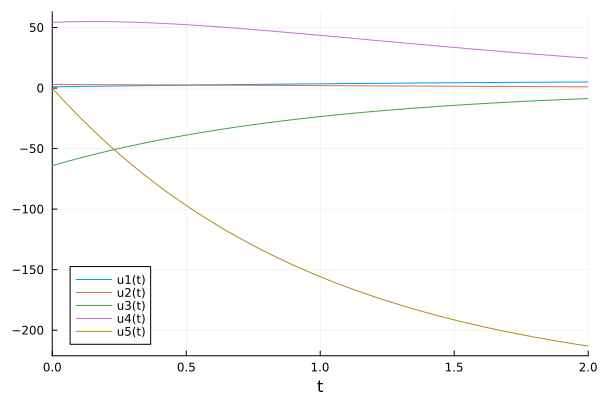

-363.53295566683613

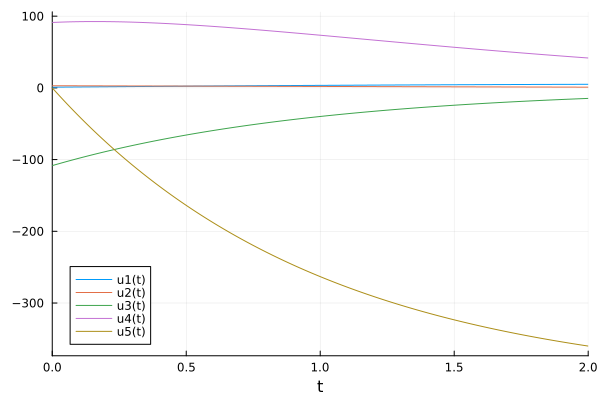

-609.9046497602133

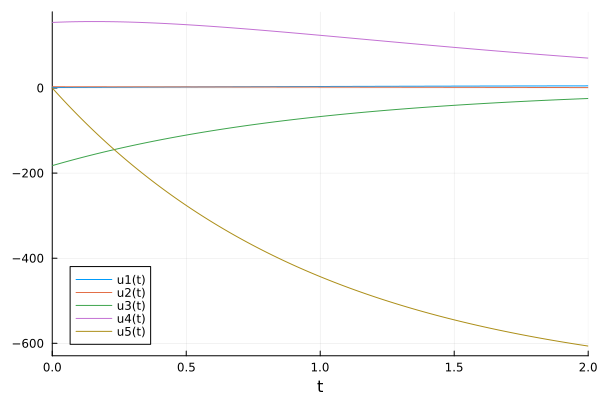

-1026.9194403330955

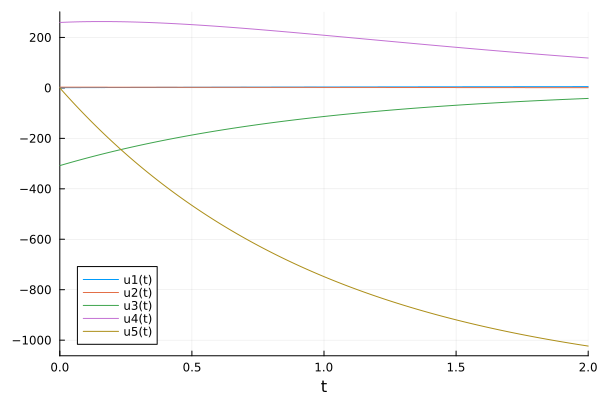

-1728.1700729169968

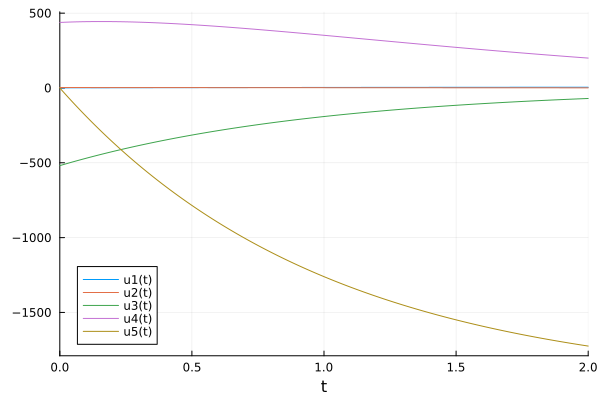

-2912.825108301593

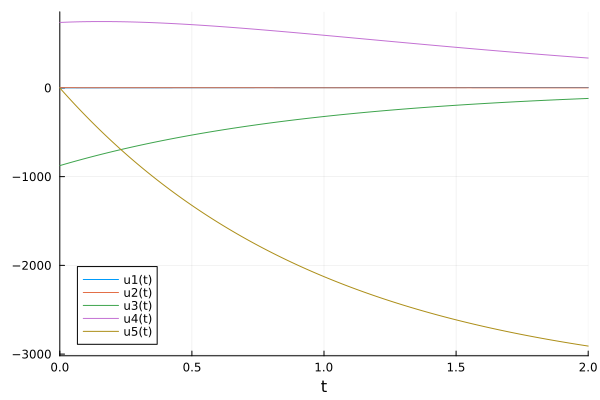

-4907.655165985554

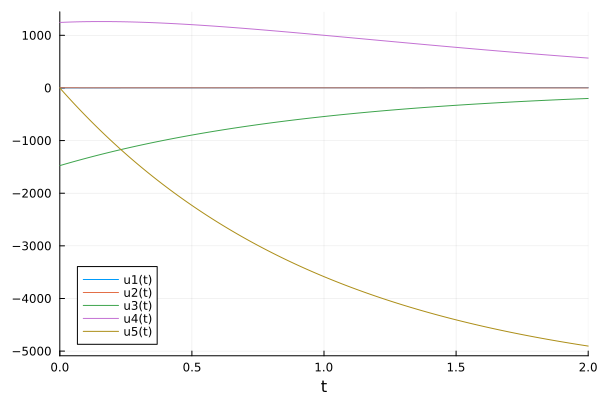

-8274.379440307099

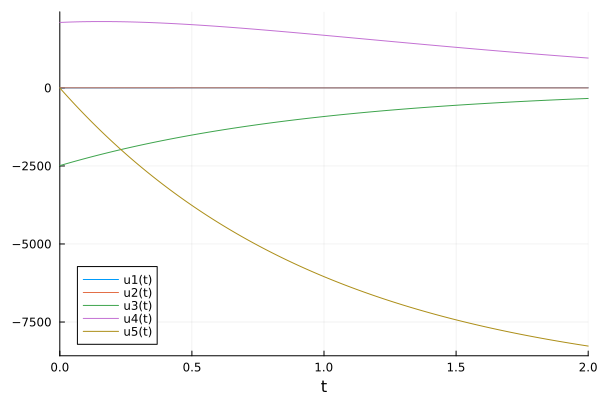

-13947.398911660974

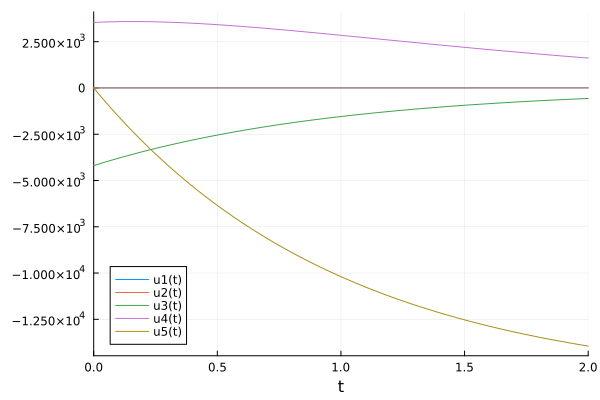

-23517.35717341875

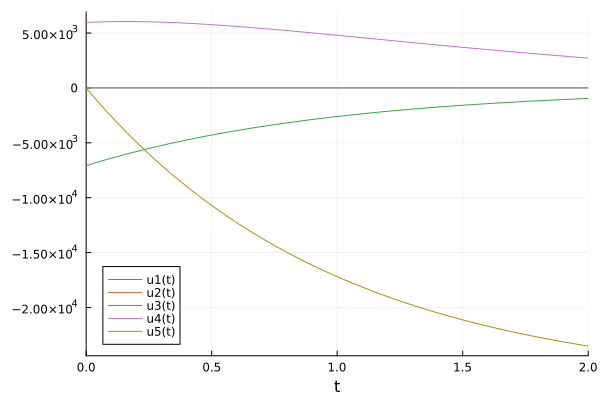

-39648.3889013182

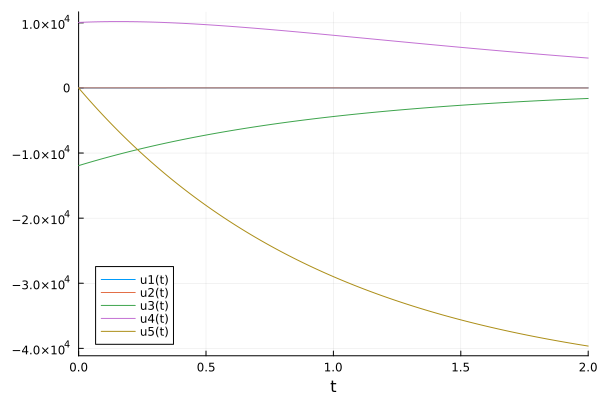

-66853.81586857657

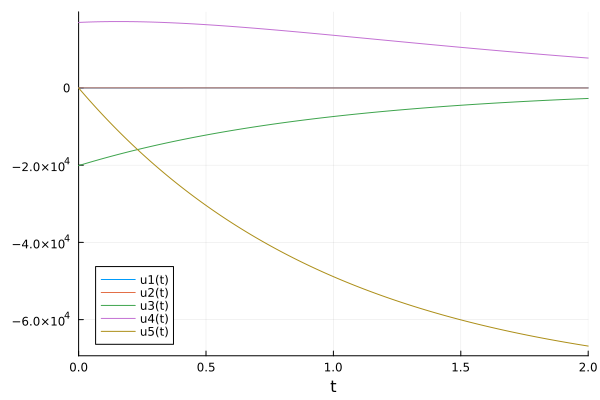

-112718.56482484545

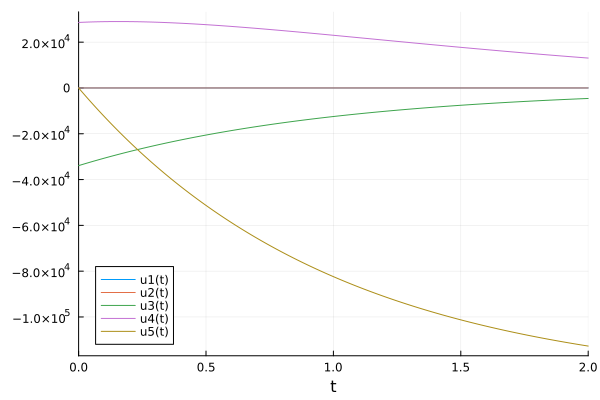

-190061.78890257643

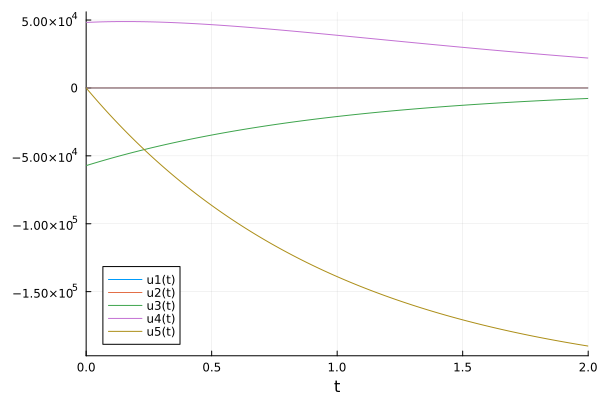

-320462.9335025827

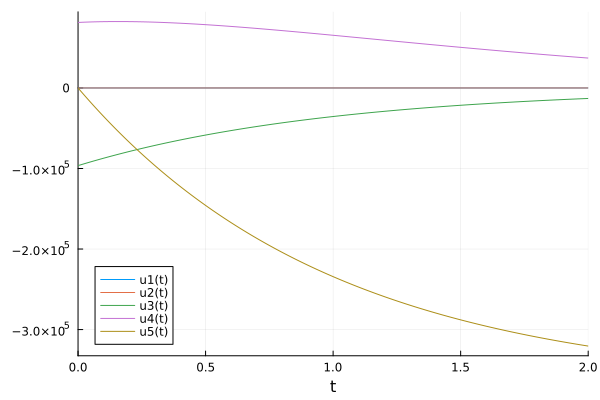

-540350.0536970418

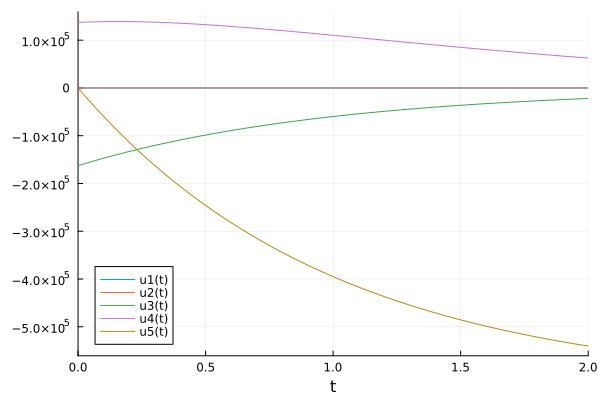

-911095.7854140701

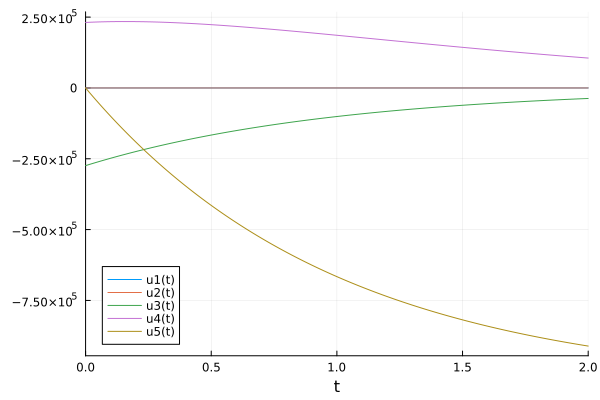

-1.5362426466231763e6

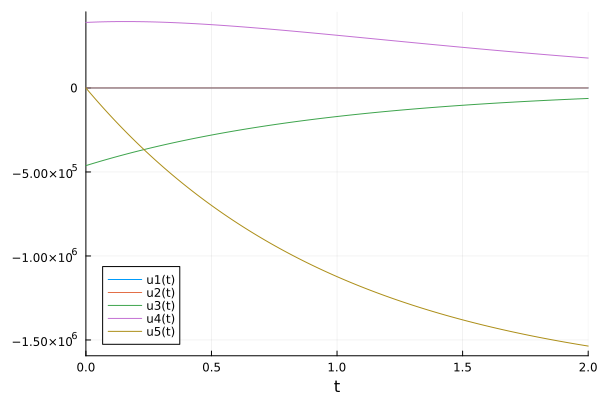

-2.5903075732976054e6

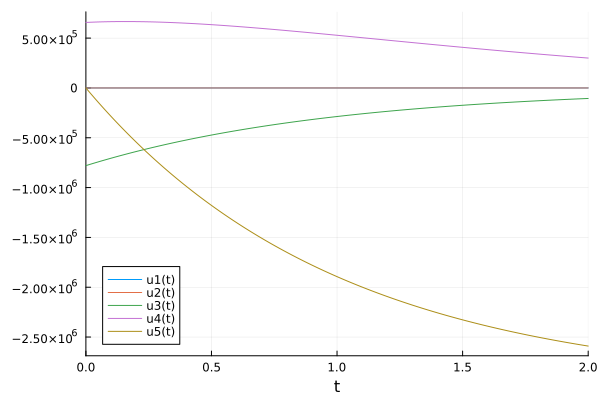

-4.367635130435866e6

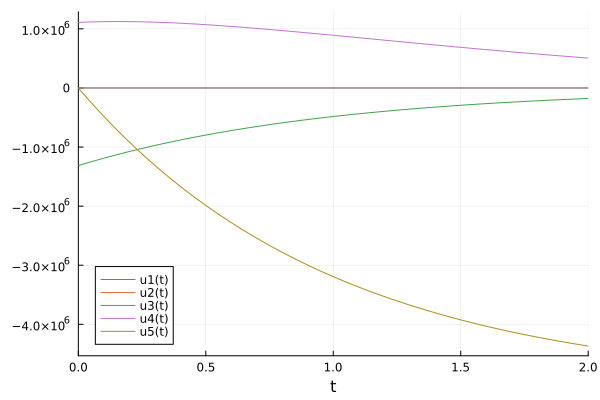

-7.364428136513702e6

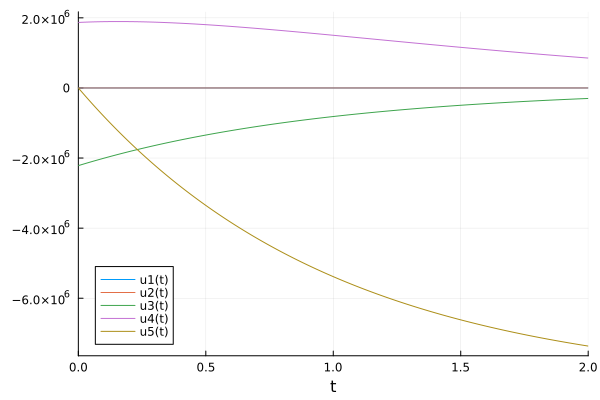

-1.2417476898834705e7

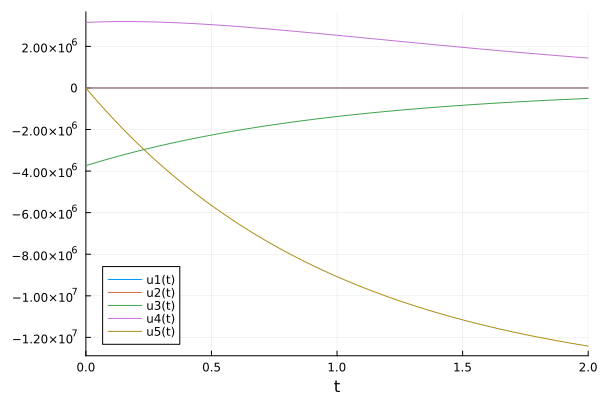

-2.09375869964293e7

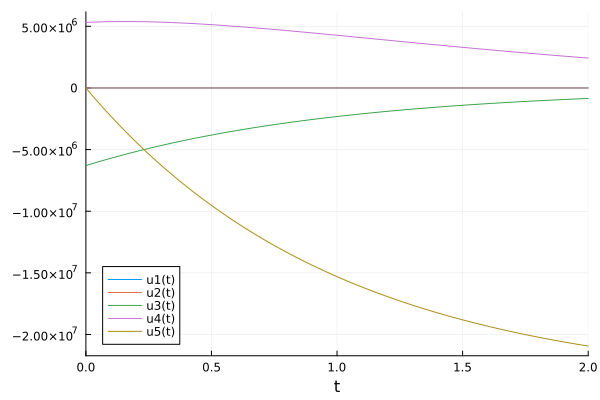

-3.530374698788974e7

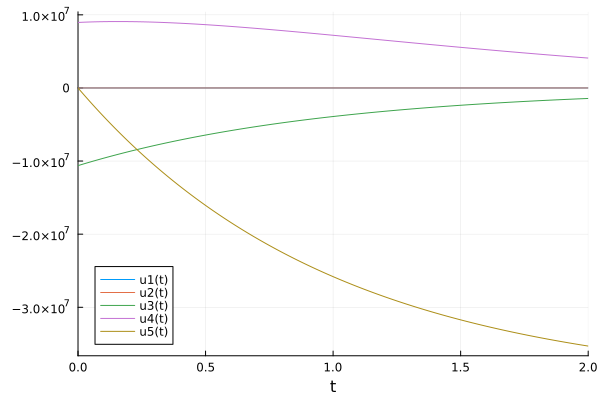

-5.952705137342764e7

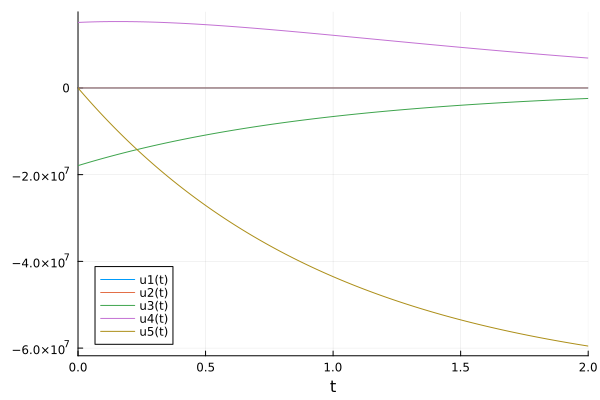

-1.0037100545119265e8

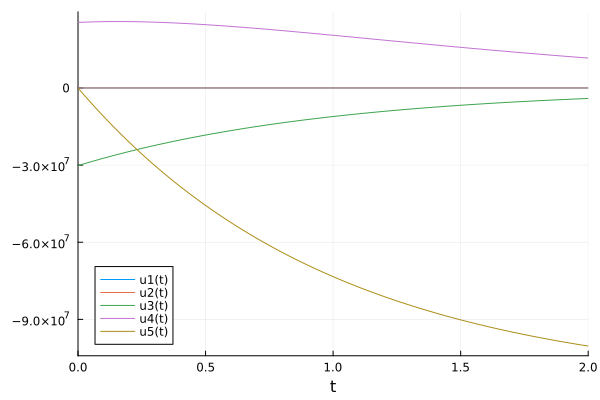

-1.692395741870802e8

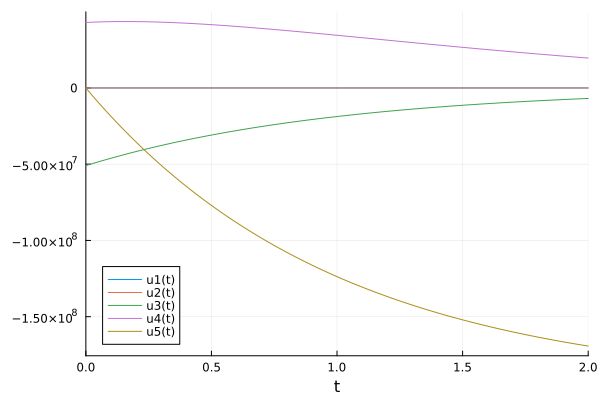

-2.853617777507436e8

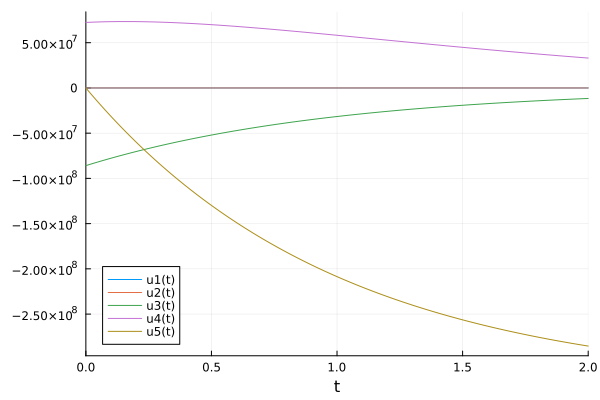

-4.811601476422805e8

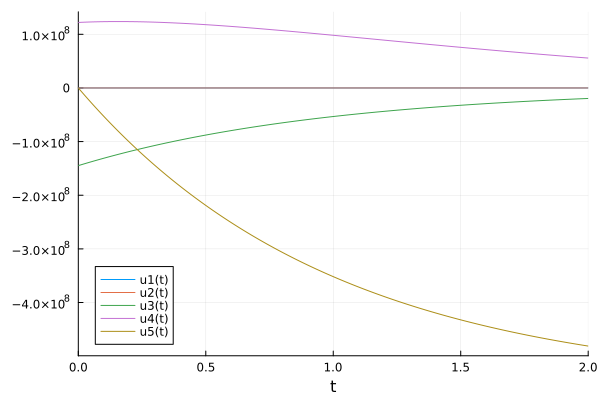

-8.113036620417506e8

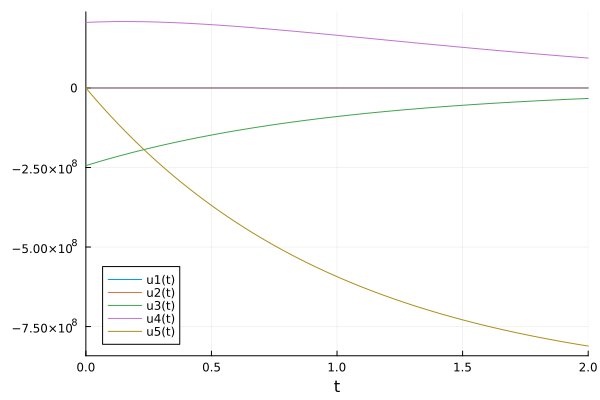

-1.367971877544363e9

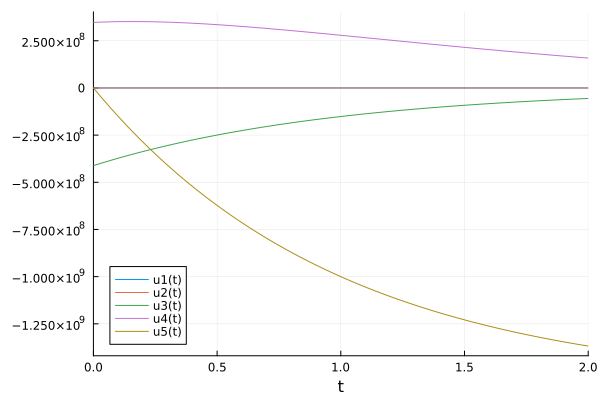

-2.306593006230932e9

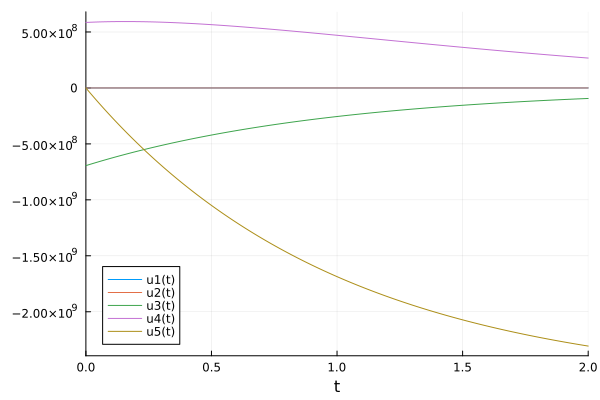

-3.889241252709328e9

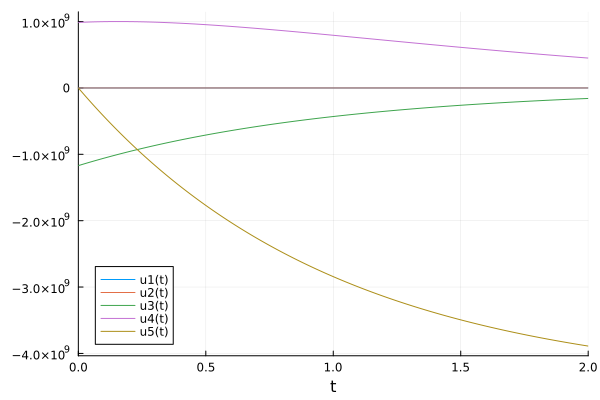

-6.557807271517358e9

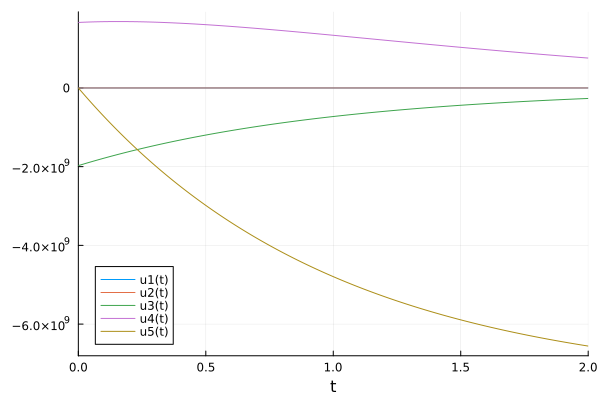

-1.105738347056335e10

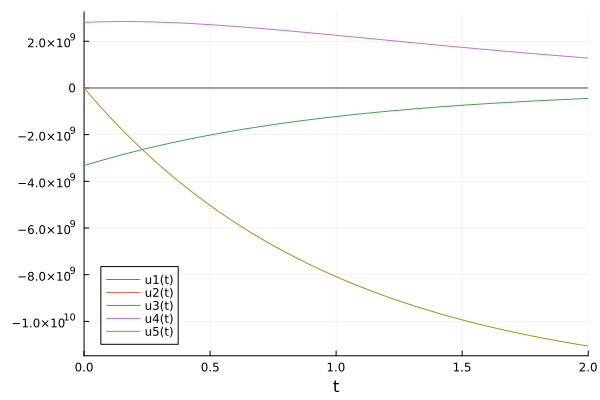

-1.8644304082966347e10

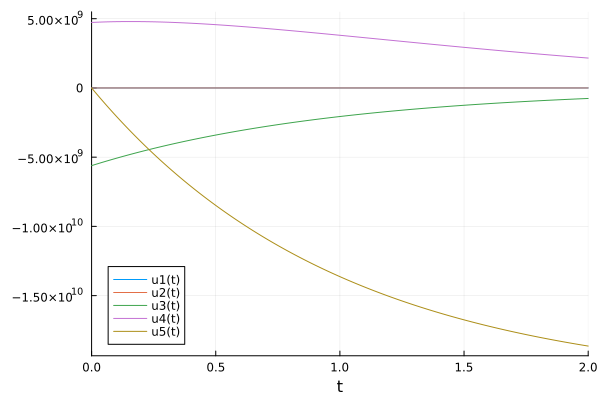

-3.1436918977564056e10

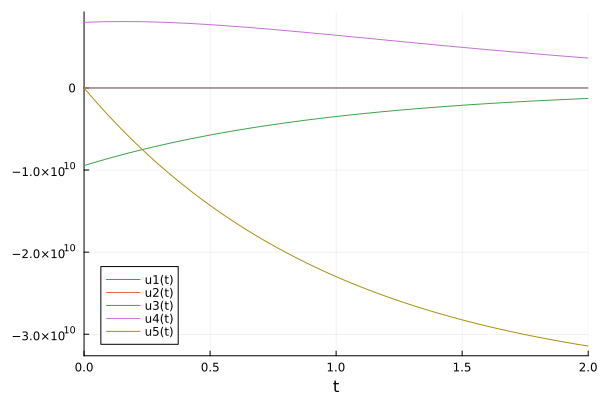

-5.300706764966248e10

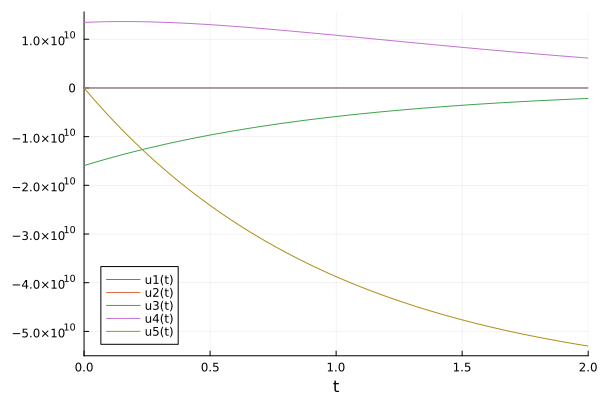

-8.937737177470482e10

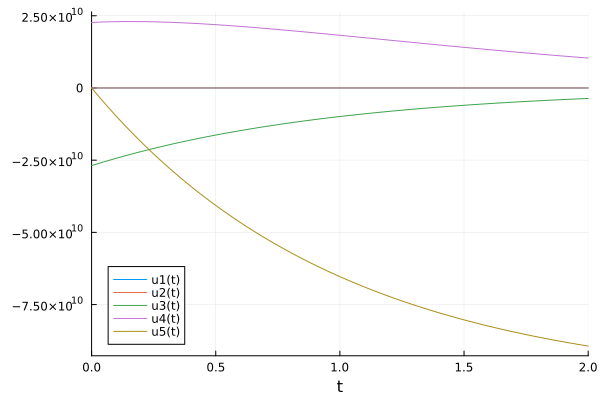

-1.5070282118142075e11

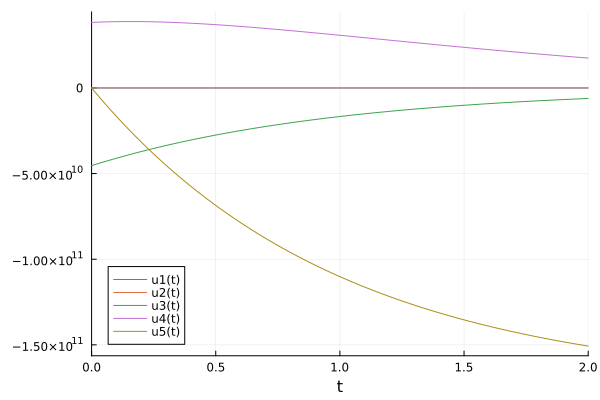

-2.5410615413527805e11

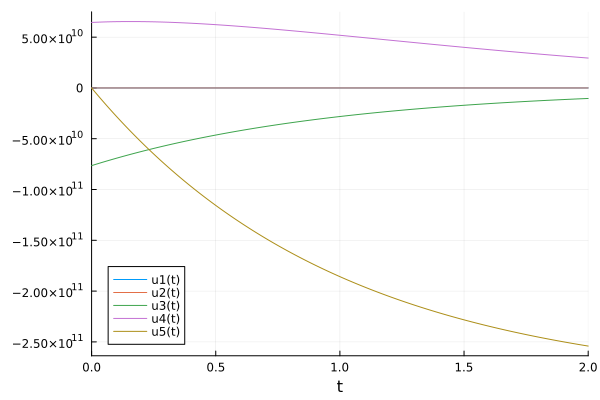

-4.284587194256426e11

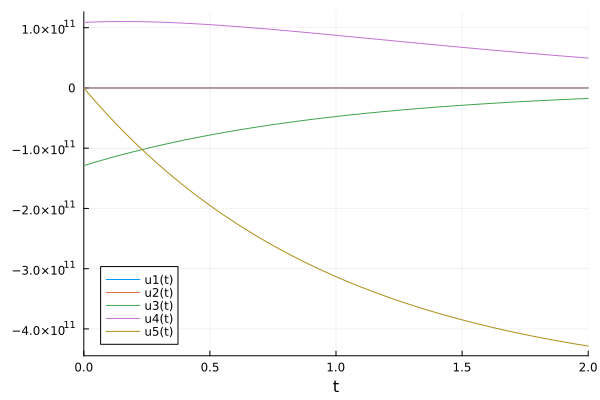

-7.224416679789585e11

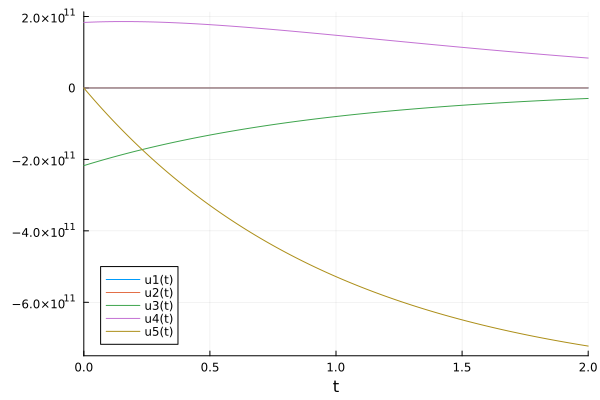

-1.2181382728342817e12

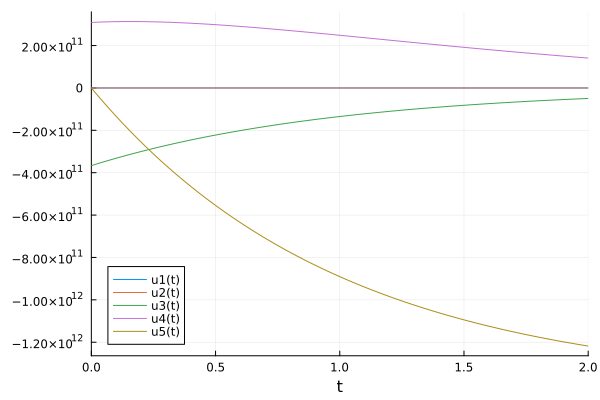

-2.053952472372902e12

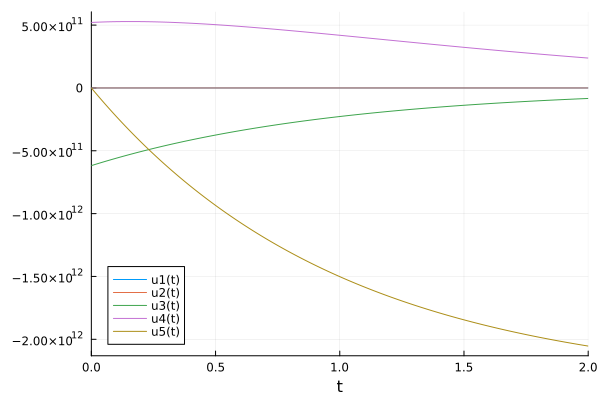

-3.4632527818533555e12

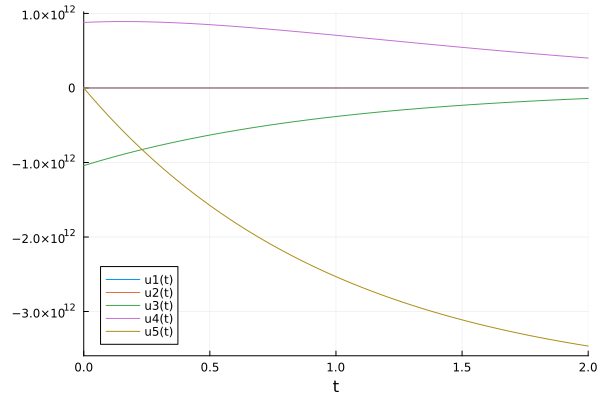

-5.839531335659319e12

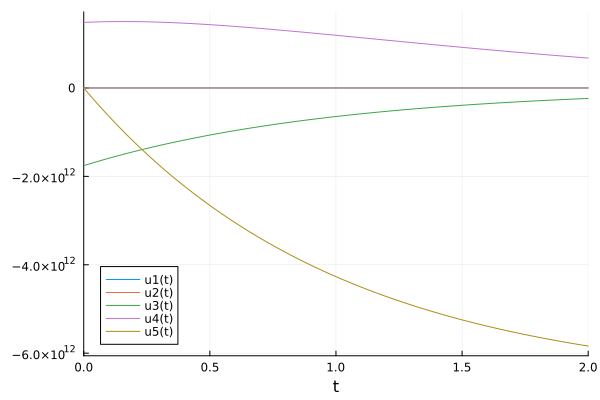

-9.846271231540451e12

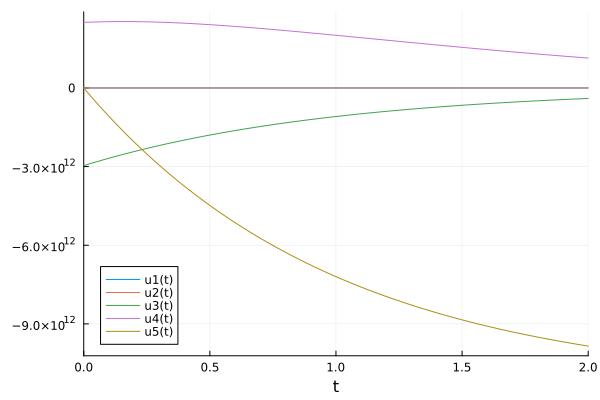

-1.6602198287074201e13

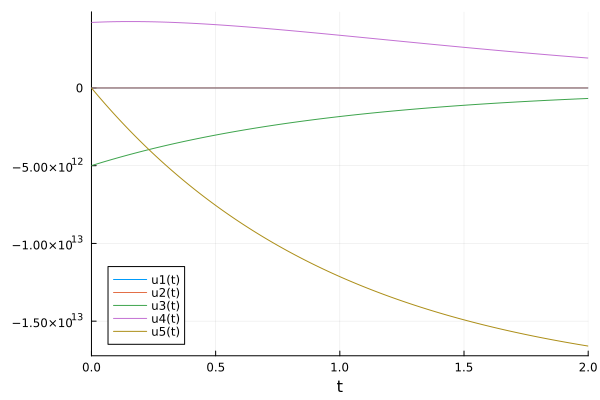

-2.7993641606581617e13

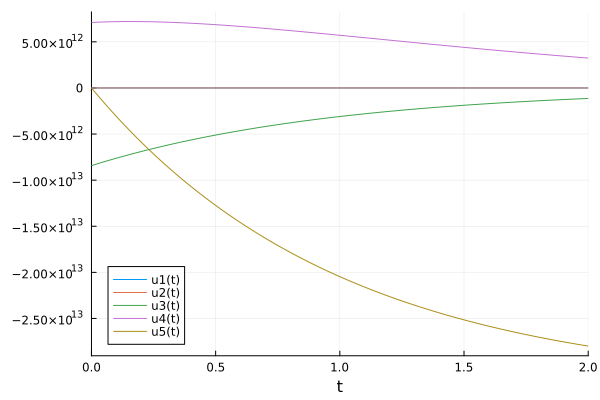

-4.720121737742348e13

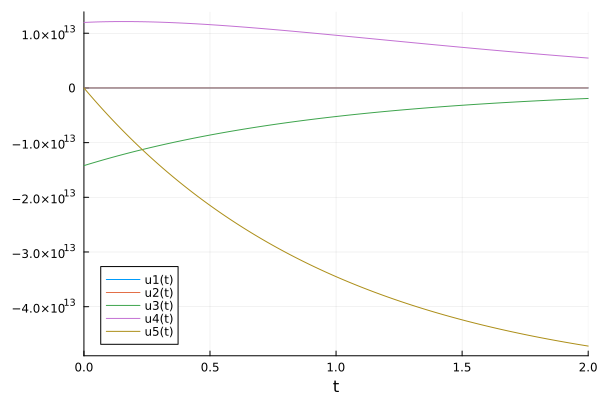

-7.958789190186722e13

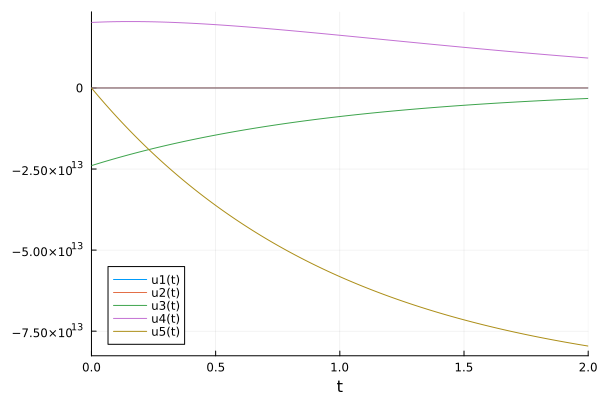

-1.3419638070582077e14

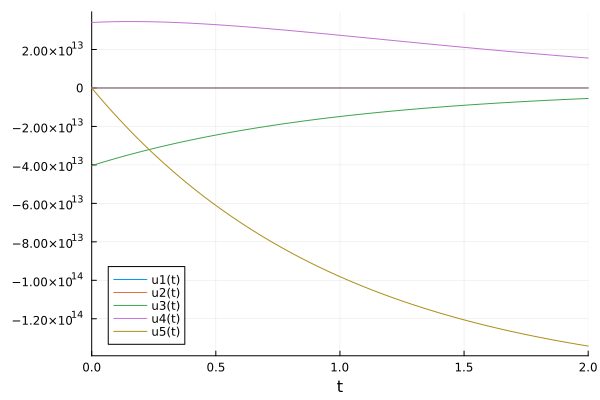

-2.2627397415674972e14

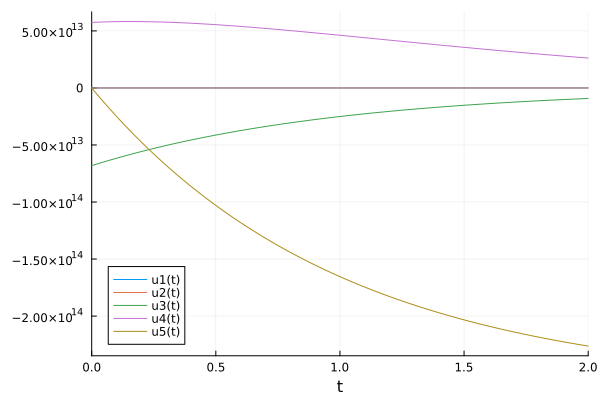

-3.815297484899803e14

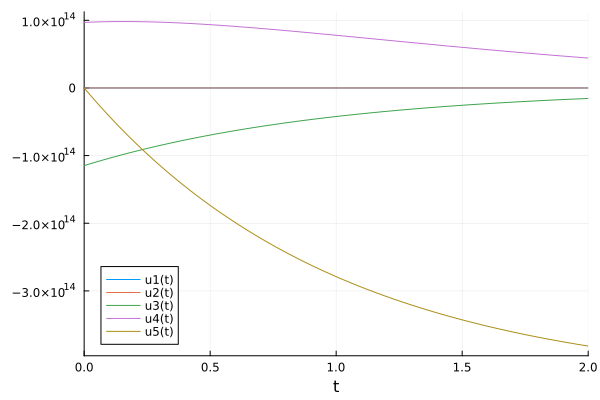

-6.433128225588561e14

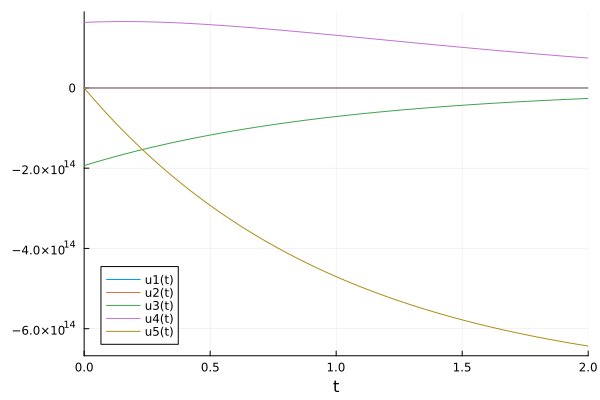

-1.0847159082597738e15

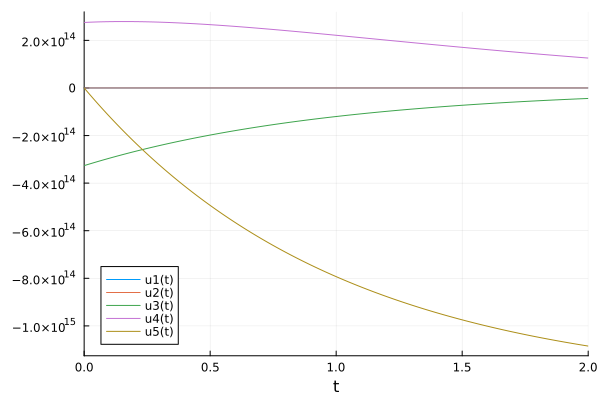

-1.8289835992479978e15

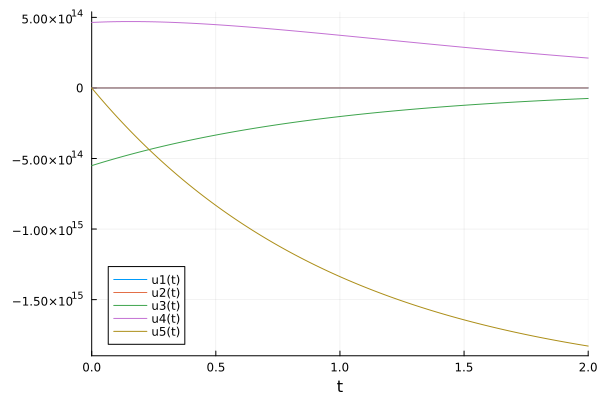

-3.083923616140579e15

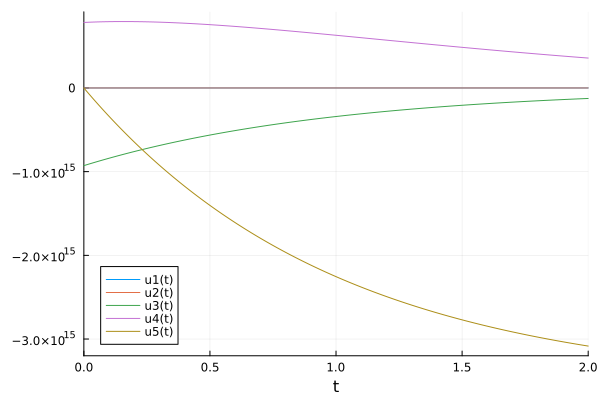

-5.199929006562368e15

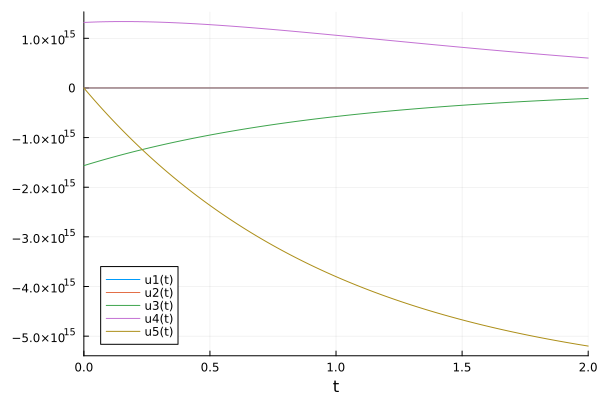

-8.767811735555538e15

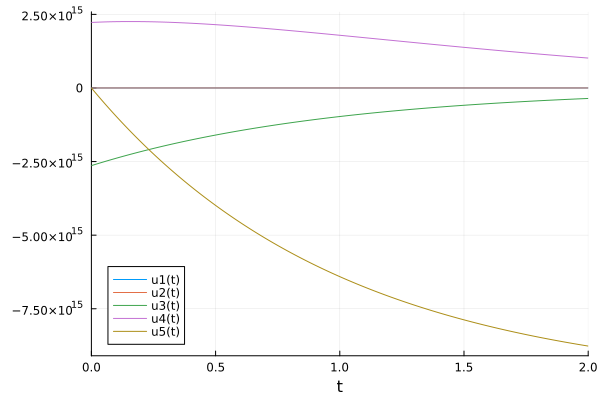

-1.4783763880906212e16

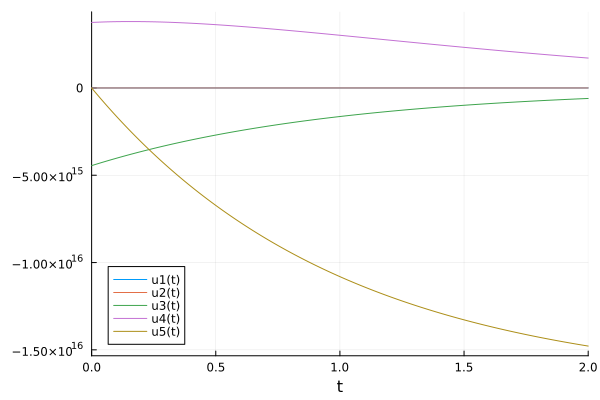

-2.492750541158965e16

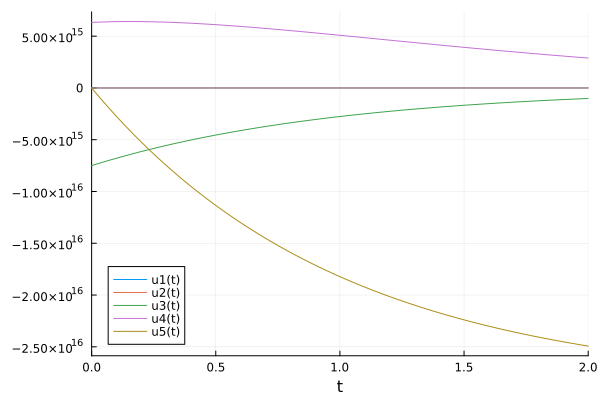

-4.203128046765856e16

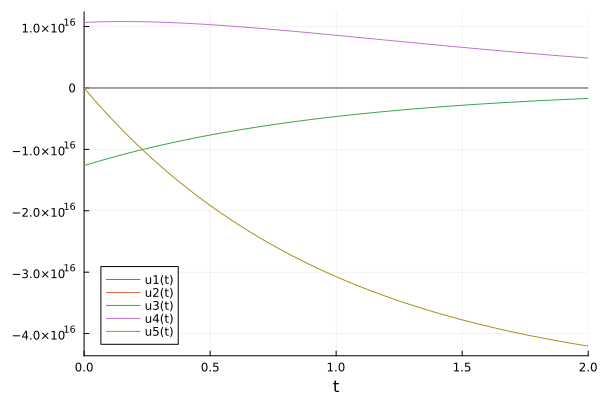

-7.087065105699165e16

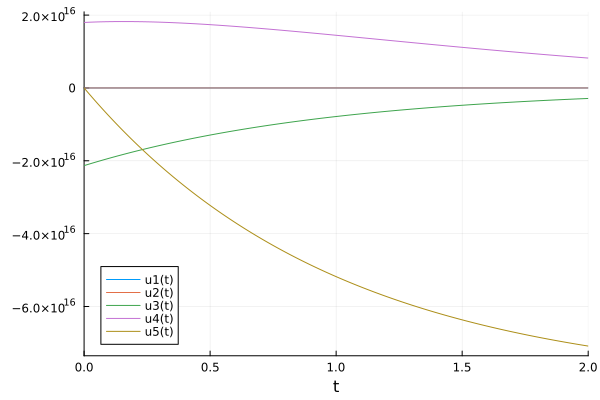

-1.1949788646377112e17

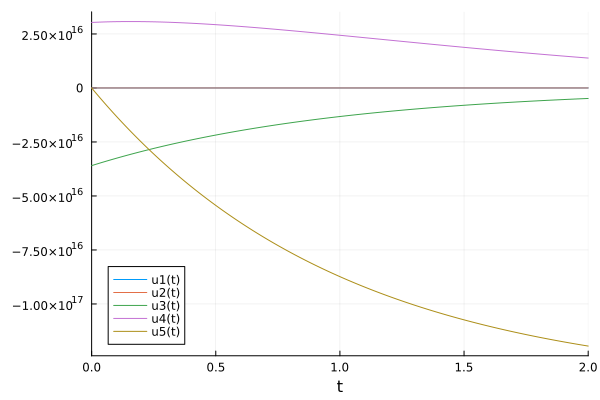

-2.0149024534590774e17

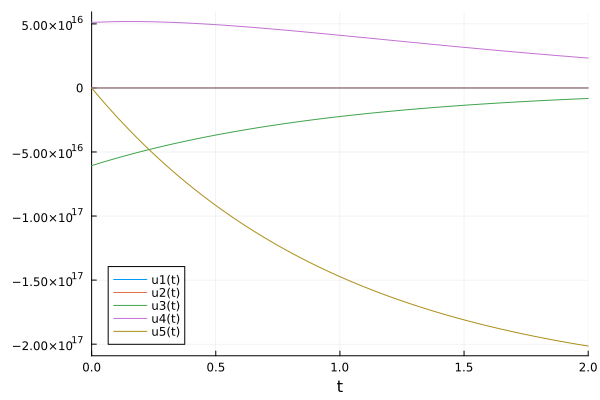

-3.39740895600782e17

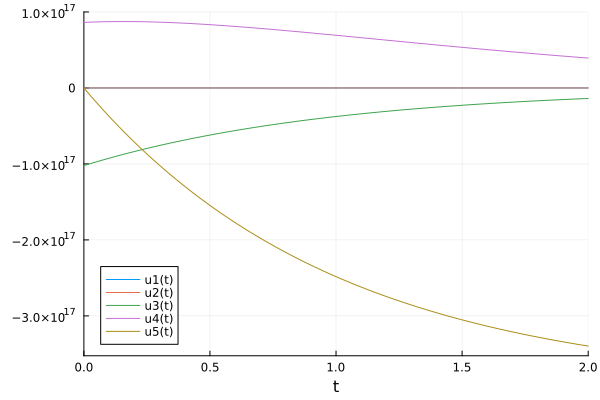

-5.7285093849164224e17

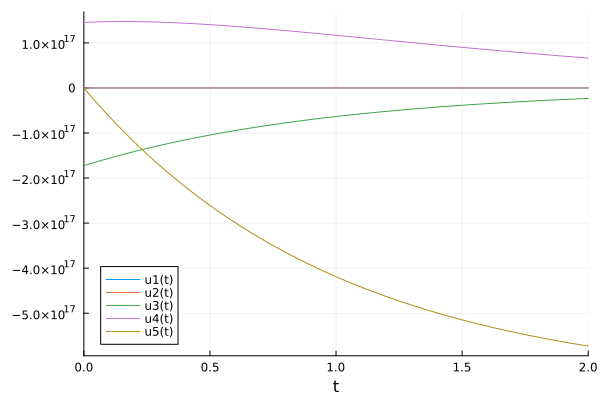

-9.65907260446574e17

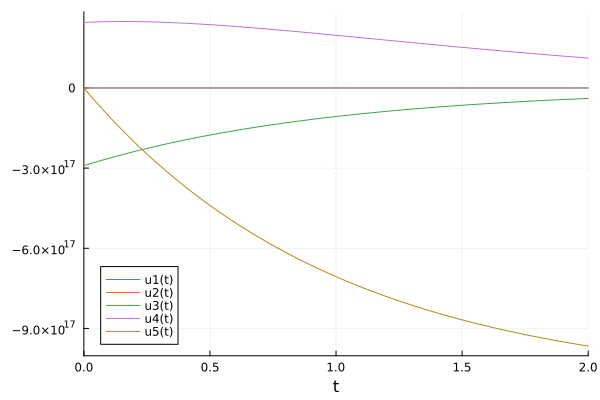

-1.6286555072079544e18

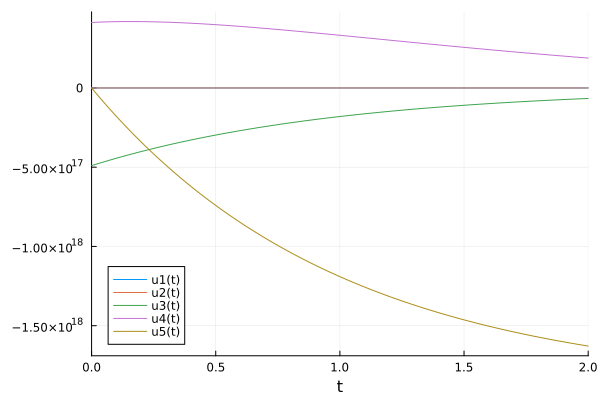

-2.746142274498398e18

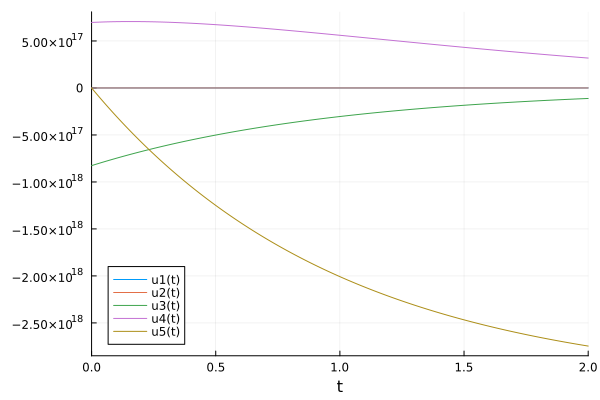

-4.630382151664212e18

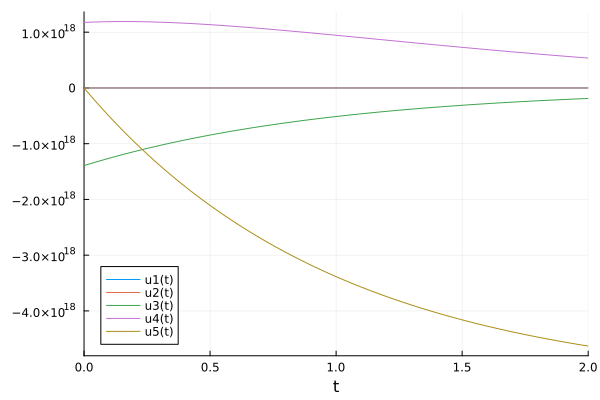

-7.807475624816298e18

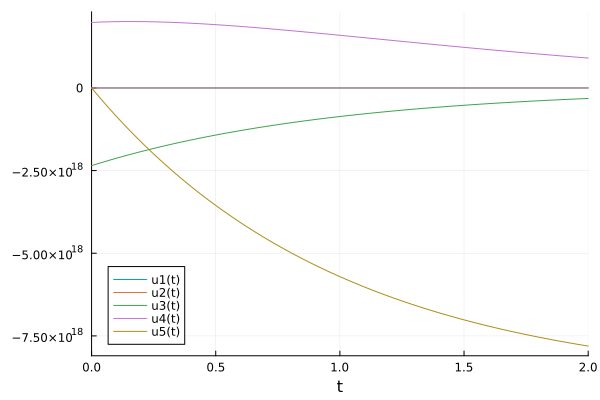

-1.316450211574596e19

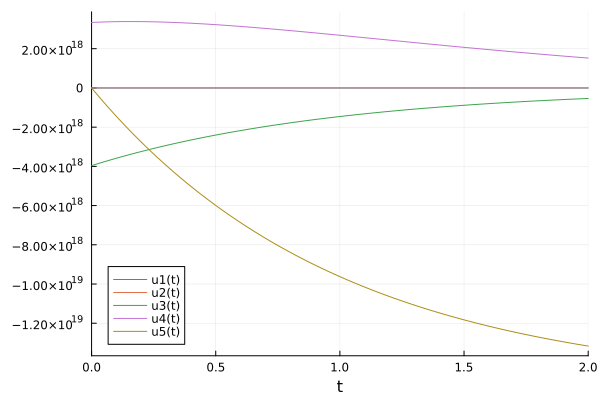

-2.2197202307529847e19

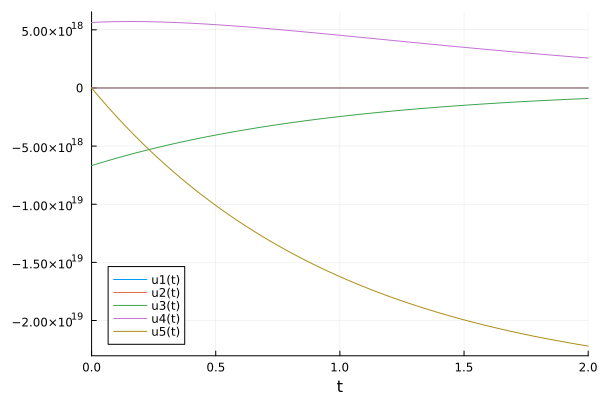

-3.7427605385212174e19

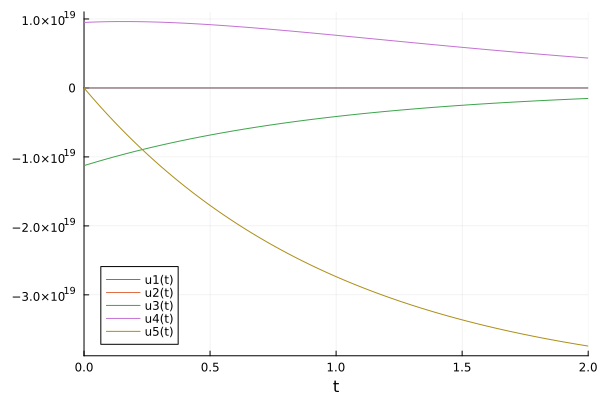

-6.3108207307625005e19

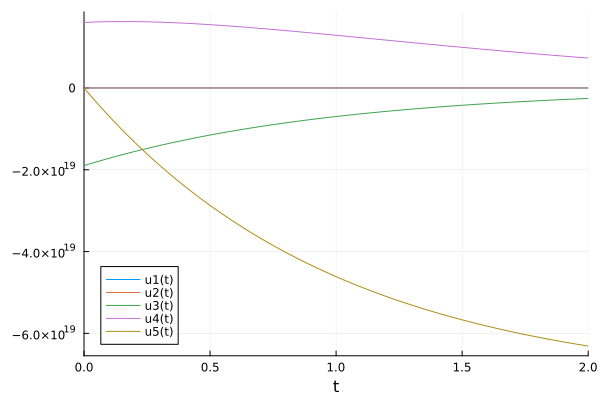

-1.0640931442429434e20

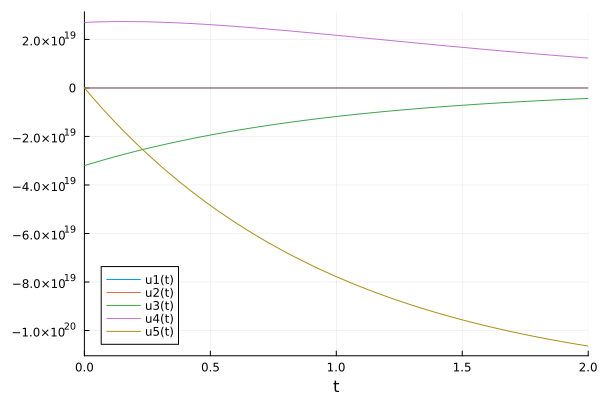

-1.7942107182737323e20

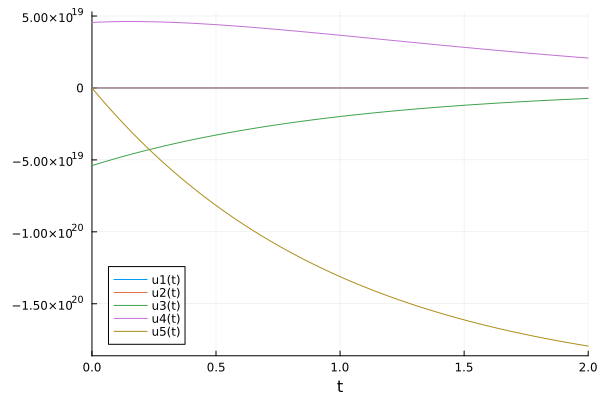

-3.025291647618213e20

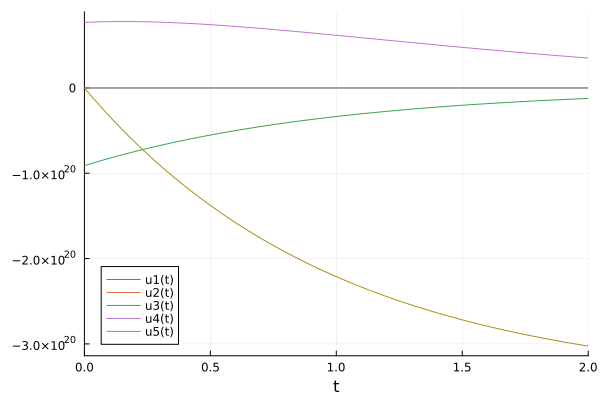

-5.1010672603669706e20

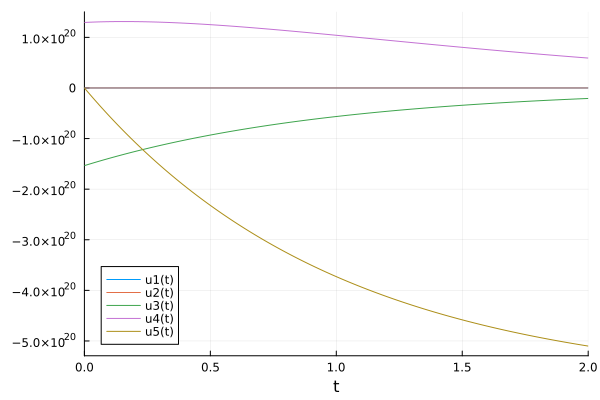

-8.601116925424899e20

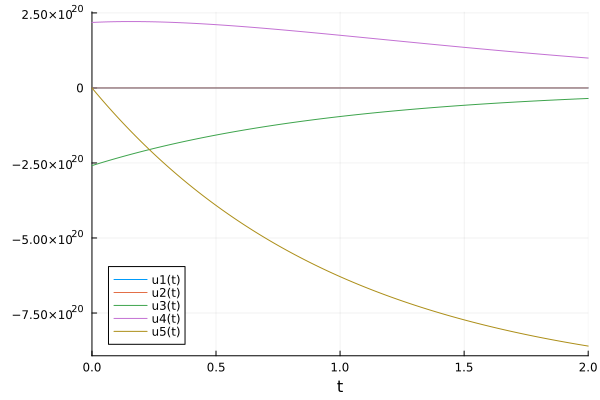

-1.450269298343623e21

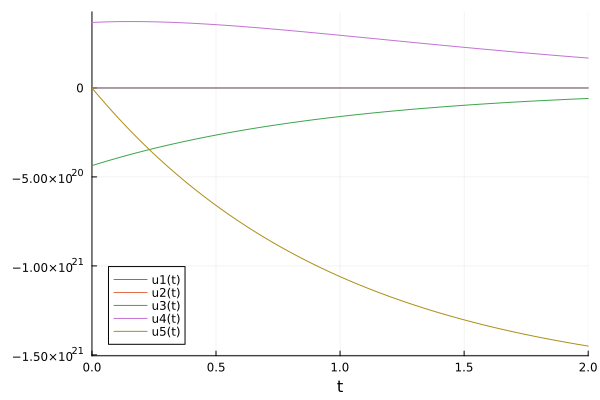

-2.445358034255651e21

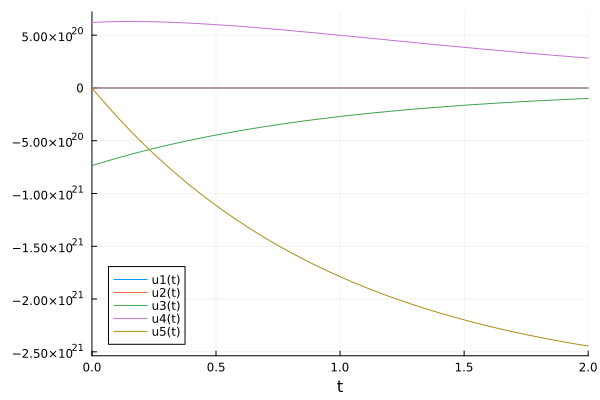

-4.1232176138179214e21

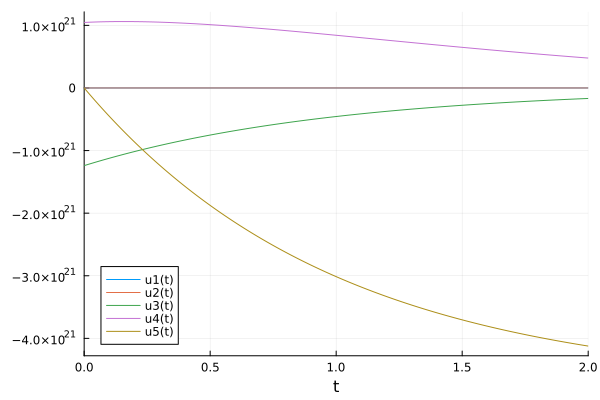

-6.952324875428778e21

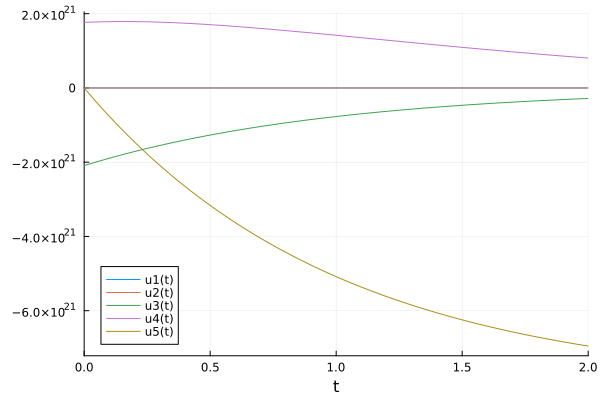

u: 2-element Vector{Float64}:
 -2.09220307782308e21
  1.7638743409571807e21

In [101]:
result_ode = Optimization.solve(optprob, NelderMead();
    callback = callback,
    maxiters = 100)  

In [102]:
result_ode

u: 2-element Vector{Float64}:
 -2.09220307782308e21
  1.7638743409571807e21

In [103]:
prob_f = ODEProblem(characteristics_system!, vcat([1.0, 3.0], [1,1.], 0.0), (0.0, 2.0))

ODEProblem with uType Vector{Float64} and tType Float64. In-place: true
timespan: (0.0, 2.0)
u0: 5-element Vector{Float64}:
 1.0
 3.0
 1.0
 1.0
 0.0

In [104]:
sol_f = solve(prob_f)

retcode: Success
Interpolation: specialized 4th order "free" interpolation, specialized 2nd order "free" stiffness-aware interpolation
t: 11-element Vector{Float64}:
 0.0
 0.0009991657263616262
 0.010990822989977889
 0.07706016228494579
 0.22740564529389534
 0.4440849853657224
 0.7057414687721508
 1.0127158727291914
 1.3379250286429354
 1.7005045474817213
 2.0
u: 11-element Vector{Vector{Float64}}:
 [1.0, 3.0, 1.0, 1.0, 0.0]
 [1.0029969980130105, 2.9990008342736383, 0.9990013332735044, 0.9980031653807079, 0.001997333452991233]
 [1.032912069874935, 2.989009177010022, 0.9890693554331078, 0.9781986692227312, 0.021861289133784757]
 [1.228211352549146, 2.922939837715054, 0.9258341516375238, 0.8544892216925599, 0.1483316967541215]
 [1.6563602721259192, 2.7725943547061047, 0.7965975814625055, 0.615446799517251, 0.40680484218177215]
 [2.2336492189835297, 2.555915014634278, 0.6414109156207488, 0.35657000966913216, 0.7171782198837406]
 [2.8681888959441157, 2.2942585312278494, 0.49374236912235575

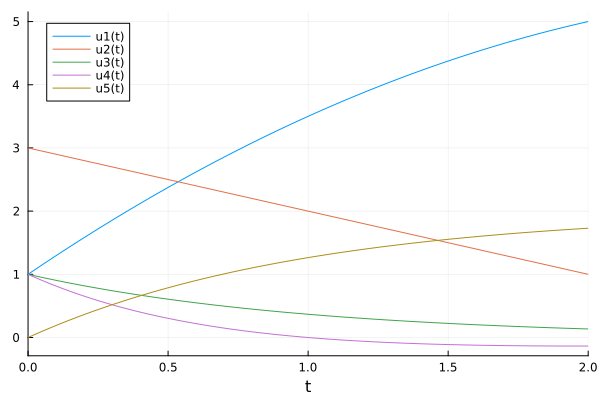

In [105]:
plot(sol_f)